<a href="https://colab.research.google.com/github/DavidAlexandreTS/Computer-Vision-2020.1/blob/main/Listas/Lista%20III/Lista3_Visao_Computacional.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Visão Computacional - Lista III
## David Silva Alexandre

### Imports

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

In [ ]:
import sys
if 'google.colab' in sys.modules:
    import subprocess
    subprocess.call("pip install -U opencv-contrib-python".split())

In [ ]:
import cv2 as cv

### Questão I

In [ ]:
img1 = cv.imread('/content/drive/MyDrive/Coisos/images/predio1.jpg')
img2 = cv.imread('/content/drive/MyDrive/Coisos/images/predio2.jpg')
img3 = cv.imread('/content/drive/MyDrive/Coisos/images/cerejeira1.jpg')
img4 = cv.imread('/content/drive/MyDrive/Coisos/images/cerejeira2.jpg')
img5 = cv.imread('/content/drive/MyDrive/Coisos/images/metropole1.png')
img6 = cv.imread('/content/drive/MyDrive/Coisos/images/metropole2.png')
img7 = cv.imread('/content/drive/MyDrive/Coisos/images/ponte1.png')
img8 = cv.imread('/content/drive/MyDrive/Coisos/images/ponte2.png')
img9 = cv.imread('/content/drive/MyDrive/Coisos/images/chihiro1.jpg')
img10 = cv.imread('/content/drive/MyDrive/Coisos/images/chihiro2.jpg')

In [ ]:
def FlannMatching(img1, img2, ratio):
    g1 = cv.cvtColor(img1, cv.COLOR_BGR2GRAY)
    g2 = cv.cvtColor(img2, cv.COLOR_BGR2GRAY)

    sift = cv.SIFT_create()

    kp1, dst1 = sift.detectAndCompute(g1, None)
    kp2, dst2 = sift.detectAndCompute(g2, None)
    
    FLANN_INDEX_KDTREE = 1
    index_params = dict(algorithm = FLANN_INDEX_KDTREE, trees = 5)
    search_params = dict(checks=100)

    flann = cv.FlannBasedMatcher(index_params,search_params)
    matchs = flann.knnMatch(dst1, dst2, k=2)

    best_matchs = []

    for m, n in matchs:
        if m.distance < ratio * n.distance:
            best_matchs.append([m])
    
    result = cv.drawMatchesKnn(img1, kp1, img2, kp2, best_matchs[0:30], None, flags = cv.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    
    plot_match_points_image(result, 'Match points')

    if len(best_matchs) > 4:
        return (best_matchs, kp1, dst1, kp2, dst2)

In [ ]:
def HomographyGen(best_matchs, kp1, kp2):
    src_pts = np.float32([kp1[m[0].queryIdx].pt for m in best_matchs ]).reshape(-1, 1, 2)
    dst_pts = np.float32([kp2[m[0].trainIdx].pt for m in best_matchs ]).reshape(-1, 1, 2)

    H, mask = cv.findHomography(src_pts, dst_pts, cv.RANSAC, 5.0)
    matchesMask = mask.ravel().tolist()
    
    return H, matchesMask

In [ ]:
def PerspectiveTransfomation(img1, img2, H):
    height_src, width_src = img1.shape[:2]
    height_dst, width_dst = img2.shape[:2]

    result = cv.warpPerspective(img2, H, (width_src + width_dst, height_src + int(height_dst/4)))
    result[0:height_src, 0:width_src] = img1
    
    return result

In [ ]:
def stitch(img1, img2, ratio):
    (good_matches, kp1, des1, kp2, des2) = FlannMatching(img1, img2, ratio)
    H, _ = HomographyGen(good_matches, kp1, kp2)

    result = PerspectiveTransfomation(img1, img2, np.linalg.inv(H))

    return result

In [ ]:
def plot_original_images(img1, img2):
    f, axarr = plt.subplots(nrows=1, ncols=2, figsize=(24, 12))
    plt.sca(axarr[0]); 
    plt.imshow(cv.cvtColor(img1, cv.COLOR_BGR2RGB)); plt.title('Original Image I')
    plt.sca(axarr[1]); 
    plt.imshow(cv.cvtColor(img2, cv.COLOR_BGR2RGB)); plt.title('Original Image II')
    plt.show()

In [ ]:
def plot_match_points_image(img, title):
    plt.subplots(figsize=(24, 12))
    plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB)),plt.title(title)
    plt.xticks([]), plt.yticks([])
    plt.show()

In [ ]:
def plot_Panoram(img, title):
    plt.subplots(figsize=(24, 12))
    plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB)),plt.title(title)
    plt.xticks([]), plt.yticks([])
    plt.show()

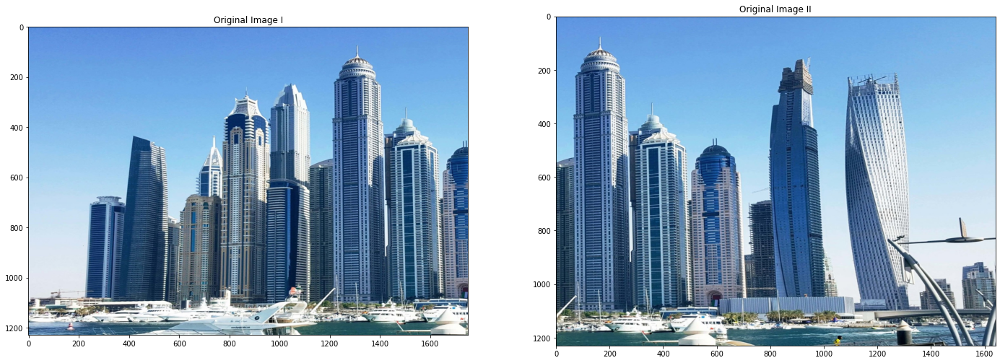

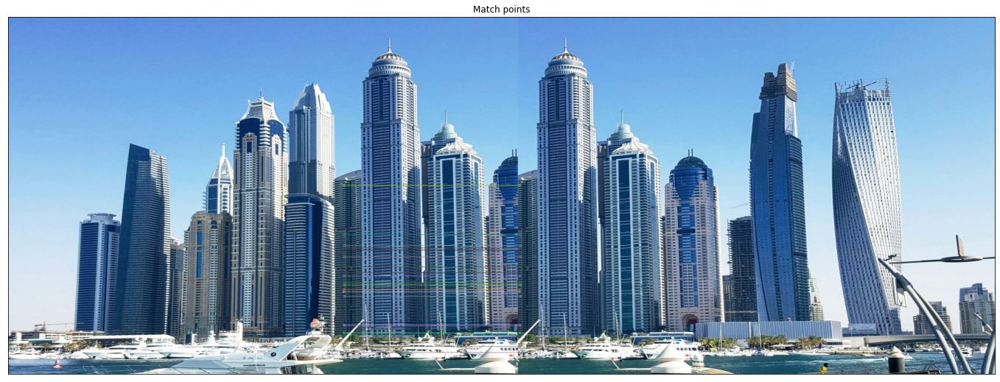

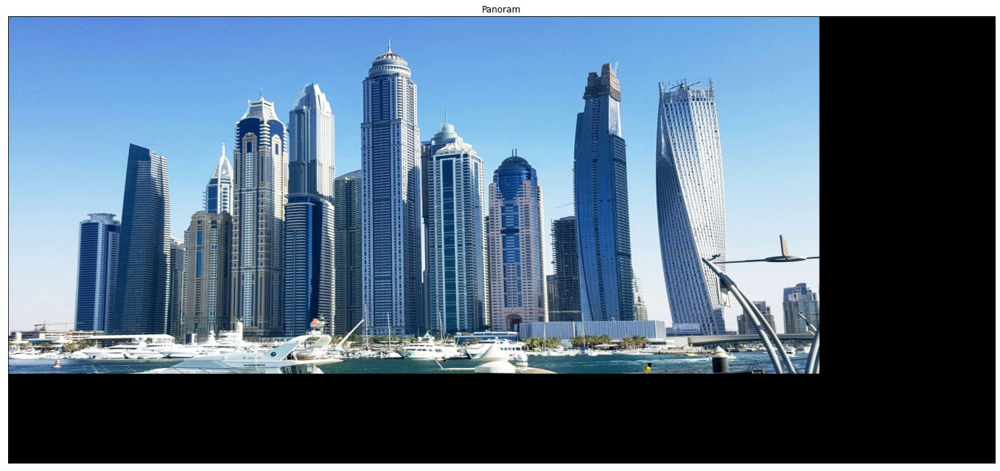

In [ ]:
plot_original_images(img1, img2)
print()
aux = stitch(img1, img2, 0.5)
print()
plot_Panoram(aux, "Panoram")

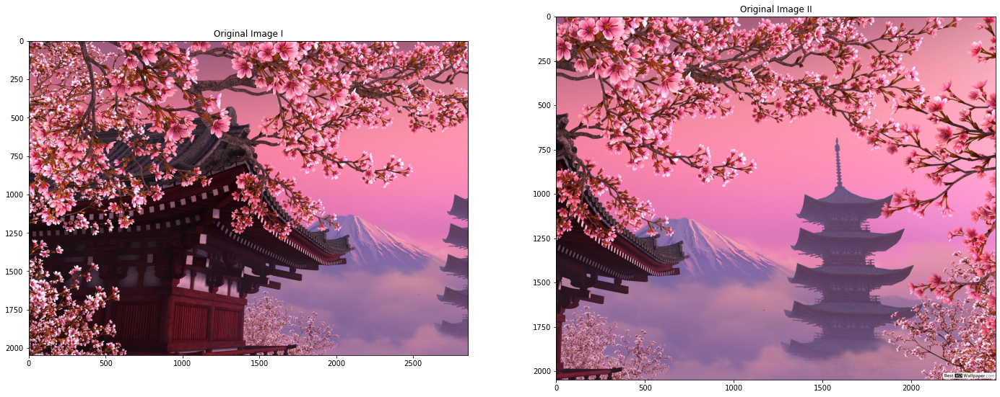

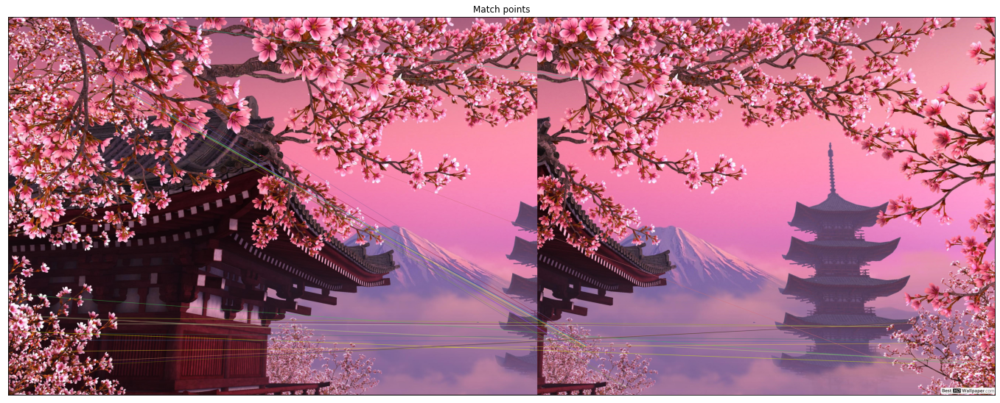

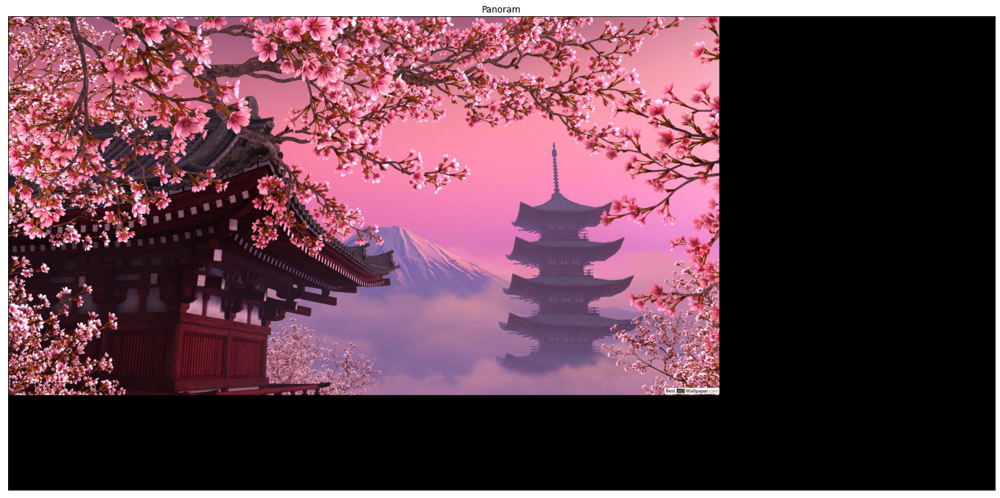

In [ ]:
plot_original_images(img3, img4)
print()
aux = stitch(img3, img4, 0.5)
print()
plot_Panoram(aux, "Panoram")

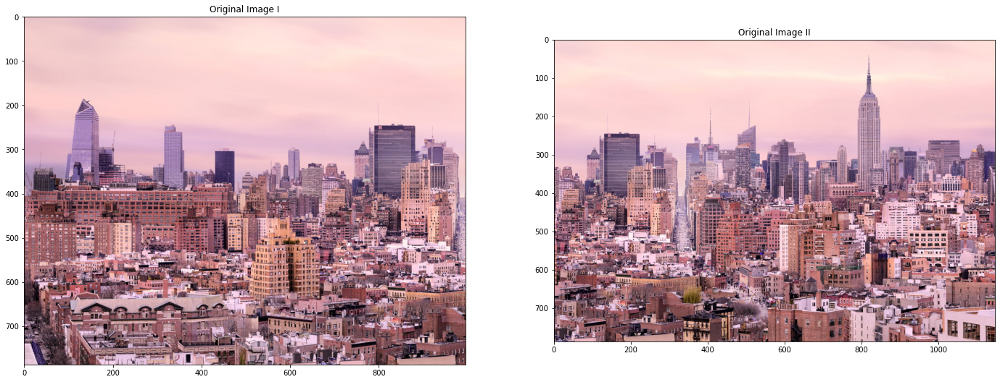

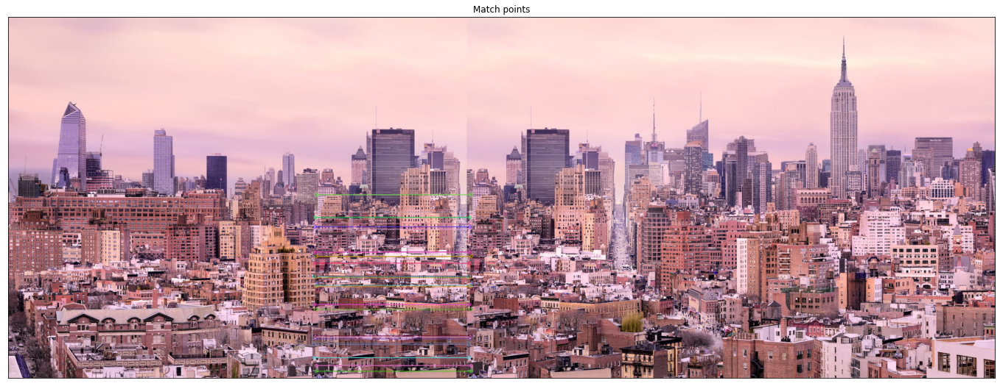

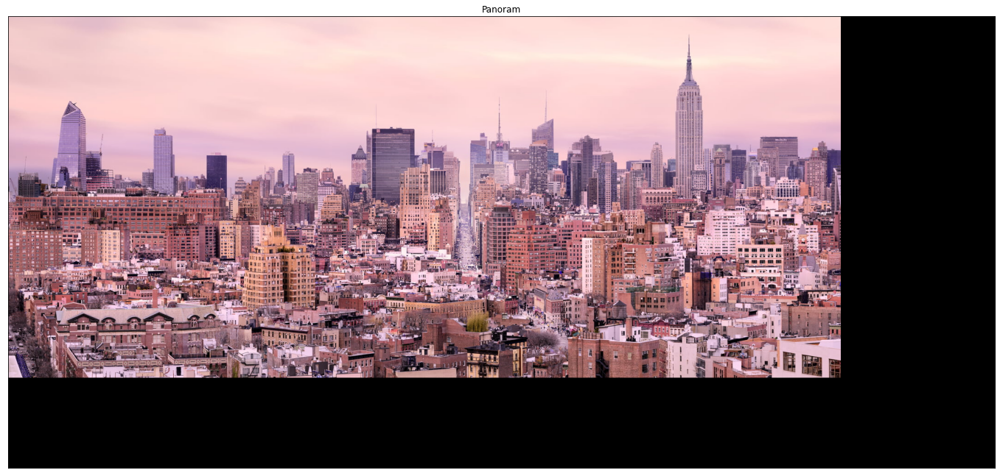

In [ ]:
plot_original_images(img5, img6)
print()
aux = stitch(img5, img6, 0.5)
print()
plot_Panoram(aux, "Panoram")

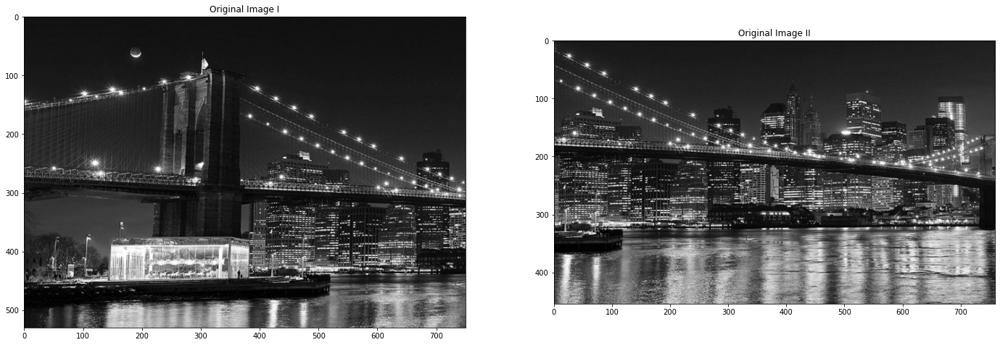

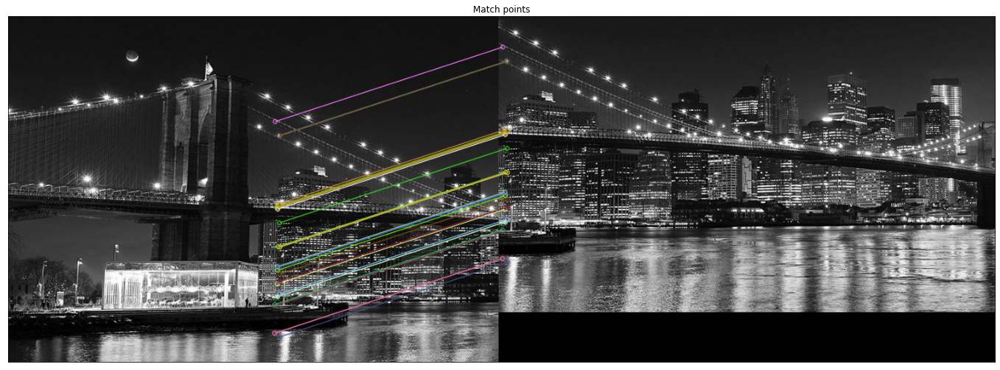

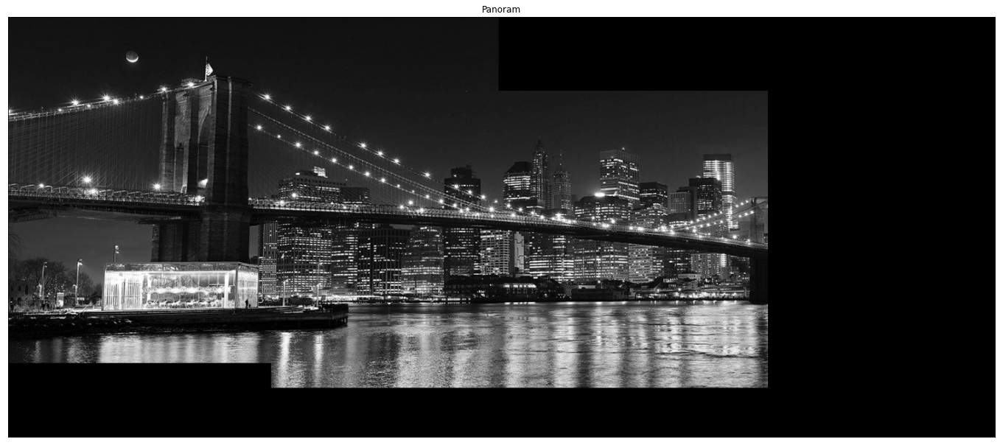

In [ ]:
plot_original_images(img7, img8)
print()
aux = stitch(img7, img8, 0.5)
print()
plot_Panoram(aux, "Panoram")

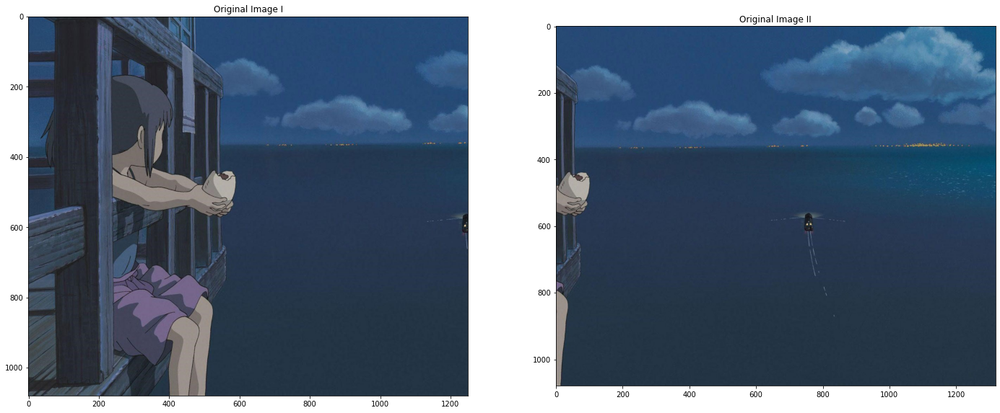

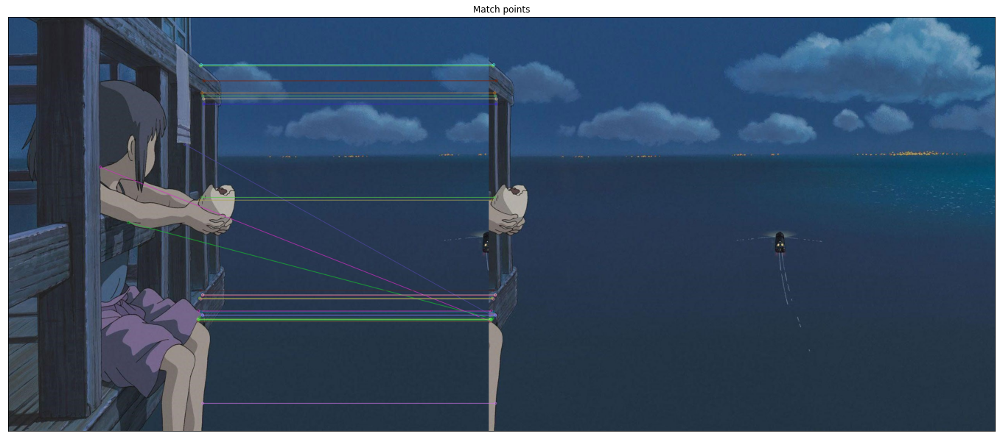

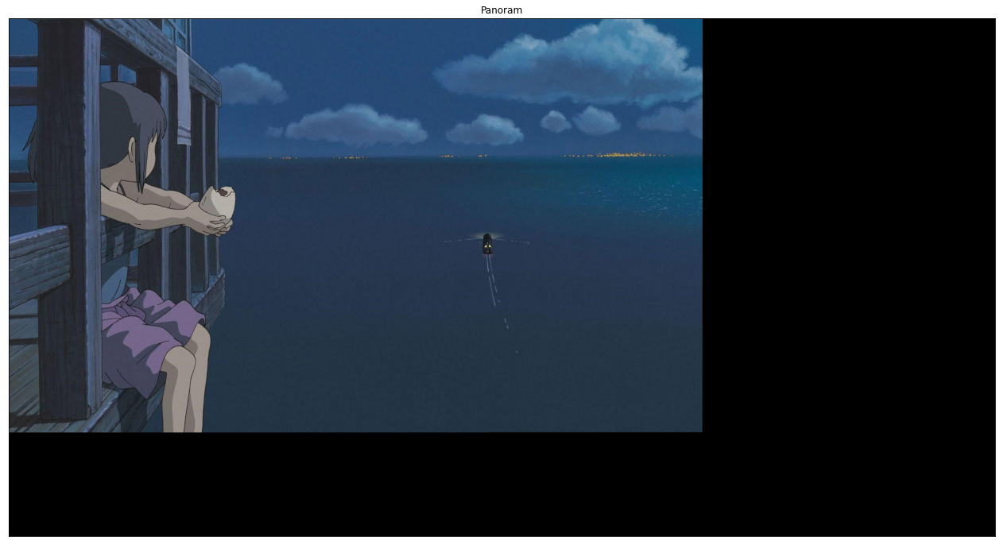

In [ ]:
plot_original_images(img9, img10)
print()
aux = stitch(img9, img10, 0.5)
print()
plot_Panoram(aux, "Panoram")

### Questão II

In [ ]:
img1 = cv.imread('/content/drive/MyDrive/Coisos/images/ponte1.png')
img2 = cv.imread('/content/drive/MyDrive/Coisos/images/ponte2.png')
img3 = cv.imread('/content/drive/MyDrive/Coisos/images/ponte3.png')

imgs = np.array((img1, img2, img3))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray
  """


In [ ]:
def plot_original_images(img1, img2, img3):
    f, axarr = plt.subplots(nrows=1, ncols=3, figsize=(40, 20))
    plt.sca(axarr[0]); 
    plt.imshow(cv.cvtColor(img1, cv.COLOR_BGR2RGB)); plt.title('Image I')
    plt.sca(axarr[1]); 
    plt.imshow(cv.cvtColor(img2, cv.COLOR_BGR2RGB)); plt.title('Image II')
    plt.sca(axarr[2]); 
    plt.imshow(cv.cvtColor(img3, cv.COLOR_BGR2RGB)); plt.title('Image III')
    plt.show()

In [ ]:
def plotImage(img, title):
    plt.subplots(figsize=(24, 12))
    plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB)),plt.title(title)
    plt.xticks([]), plt.yticks([])
    plt.show()

In [ ]:
def detectionAndDiscription(imgs):
  sift = cv.SIFT_create()
  keypoints_sift = []
  descriptors_sift = []

  for item in imgs:
    keyp, desc1 = sift.detectAndCompute(item, None)
    keypoints_sift.append(keyp)
    descriptors_sift.append(desc1)
    
  return keypoints_sift, descriptors_sift

keypoints_sift, descriptors_sift = detectionAndDiscription(imgs)

In [ ]:
def matchBF(descriptors_sift, n):
  bforce = cv.BFMatcher(cv.NORM_L2, crossCheck=True)
  matches = bforce.match(descriptors_sift[n],descriptors_sift[n+1])
  good_matches = sorted(matches, key = lambda m:m.distance)
  return good_matches

matches12 = matchBF(descriptors_sift, 0)

In [ ]:
def getHomografhy(keypoints_sift, good_matches, n):
  p1 = []
  p2 = []
  for match in good_matches:
    x, y = keypoints_sift[n][match.queryIdx].pt
    a, b = keypoints_sift[n+1][match.trainIdx].pt
    p1.append([x, y])
    p2.append([a, b])
  p1 = np.float32(p1)
  p2 = np.float32(p2)
  M, mask = cv.findHomography(p2, p1, cv.RANSAC, 5.0)
  
  return M

M1 = getHomografhy(keypoints_sift, matches12, 0)  

In [ ]:
matches23 = matchBF(descriptors_sift, 1)

In [ ]:
M2 = getHomografhy(keypoints_sift, matches23, 1)

In [ ]:
def alline(imgs, M):
  w = np.array([[imgs[1].shape[1], 0, 1], [imgs[1].shape[1], imgs[1].shape[0], 1], [0, imgs[1].shape[0], 1], [0, 0, 1]])
  s = np.dot(M, w.T)
  for col in range(s.shape[1]):
    s[0, col] =  s[0, col] / s[2,col]
    s[1, col] =  s[1, col] / s[2,col]
  s = np.int32(s)
  dx = max(s[0])
  dy = max(s[1])
  dst = cv.warpPerspective(imgs[1], M, ( max(dx, imgs[0].shape[1]), max(dy, imgs[0].shape[0])), borderValue = [255,255,255])
  dst[:imgs[0].shape[0],:imgs[0].shape[1]] = imgs[0]
  return dst

img12 = alline(imgs[0:2], M1)

In [ ]:
img_final = alline([img12, imgs[2]], np.dot(M1, M2))

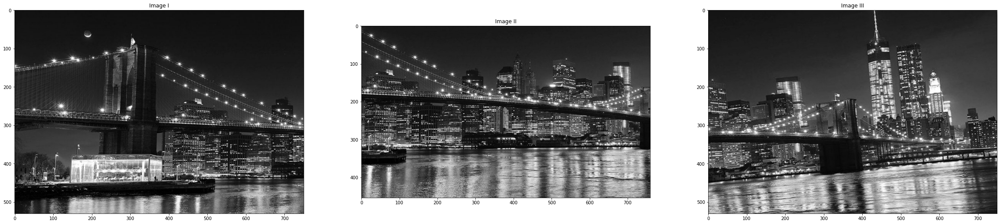

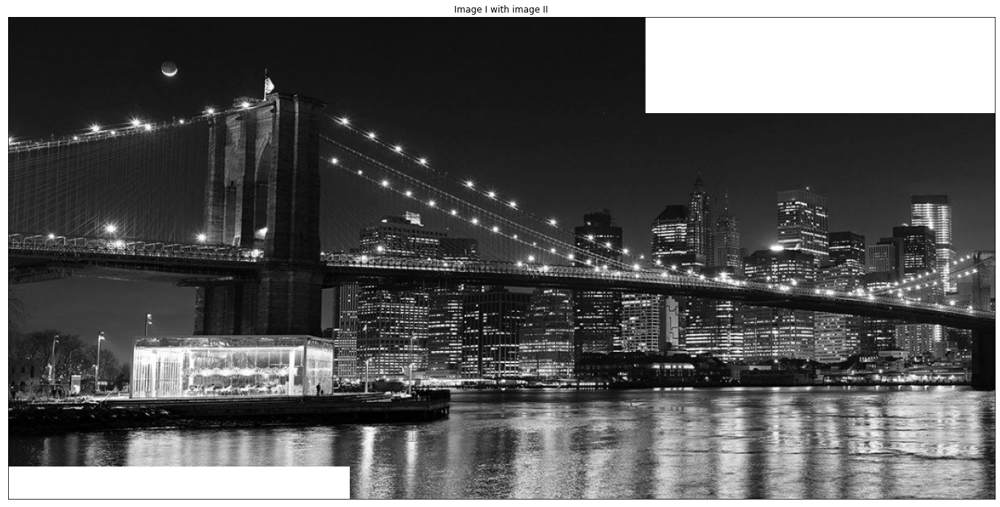

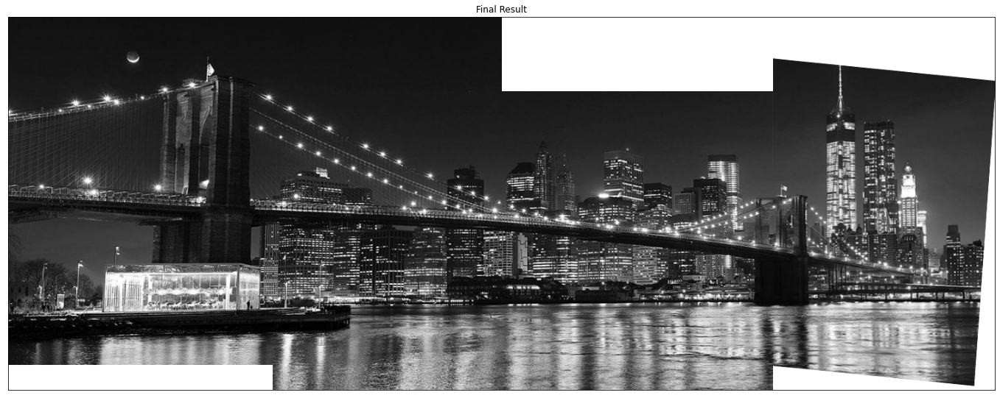

In [ ]:
plot_original_images(imgs[0], imgs[1], imgs[2])
print()
plotImage(img12, "Image I with image II")
print()
plotImage(img_final, "Final Result")

In [101]:
name = ['/content/drive/MyDrive/Coisos/images/city', '/content/drive/MyDrive/Coisos/images/metropole', '/content/drive/MyDrive/Coisos/images/palacius', '/content/drive/MyDrive/Coisos/images/hush']

n = 4

img_list = []

for i in range(0, n):
  img1 = cv.imread(name[i] + '1.png')
  img2 = cv.imread(name[i] + '2.png')
  img3 = cv.imread(name[i] + '3.png')
  imgs = [img1, img2, img3]
  img_list.append(imgs)

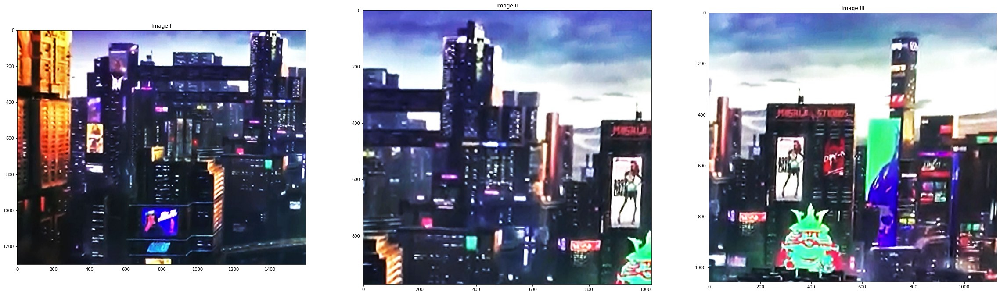

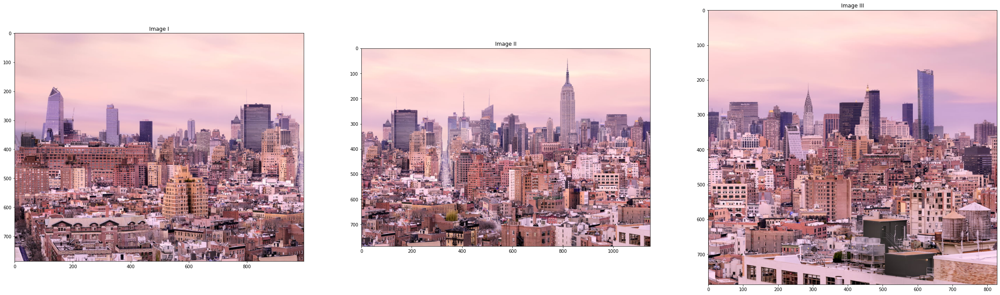

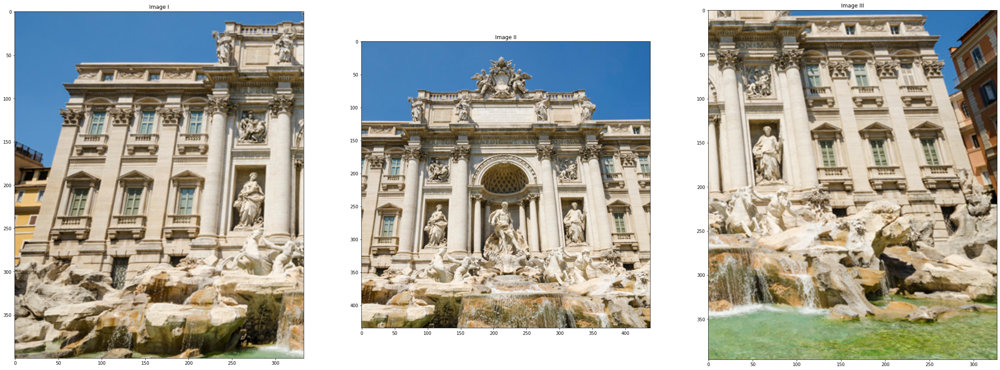

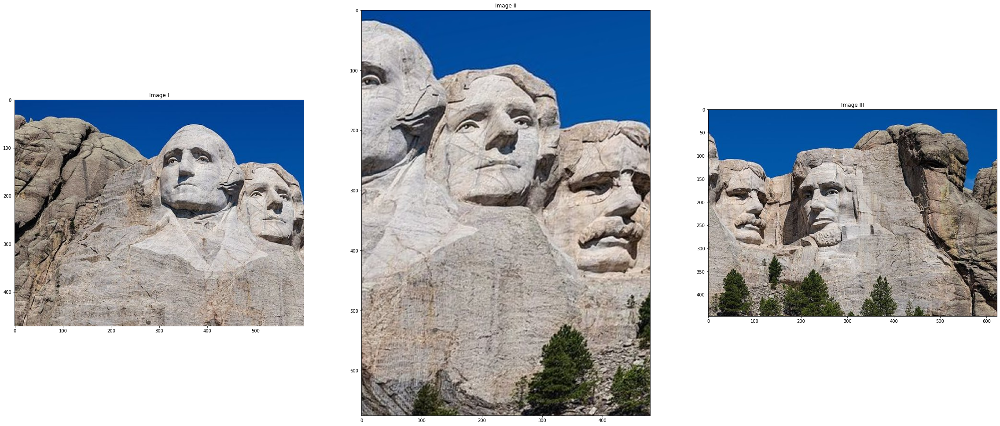

In [102]:
for i in range(0, n):
  plot_original_images(img_list[i][0], img_list[i][1], img_list[i][2])
  print()

In [105]:
keypoints = []
descriptors = []
for i in range(0, n):
  k1, d1 = detectionAndDiscription(img_list[i])
  keypoints.append(k1)
  descriptors.append(d1)

match12 = []
match23 = []
for i in range(0,n):
  match12.append(matchBF(descriptors[i], 0)) 
  match23.append(matchBF(descriptors[i], 1))

A1 = []
A2 = []
for i in range(0,n):
  A1.append(getHomografhy(keypoints[i], match12[i], 0))
  A2.append(getHomografhy(keypoints[i], match23[i], 1))

image = []
for i in range(0,n):
  img12 = alline(img_list[i][0:2], A1[i])
  img_final = alline([img12, img_list[i][2]], np.dot(A1[i], A2[i]))
  image.append(img_final)


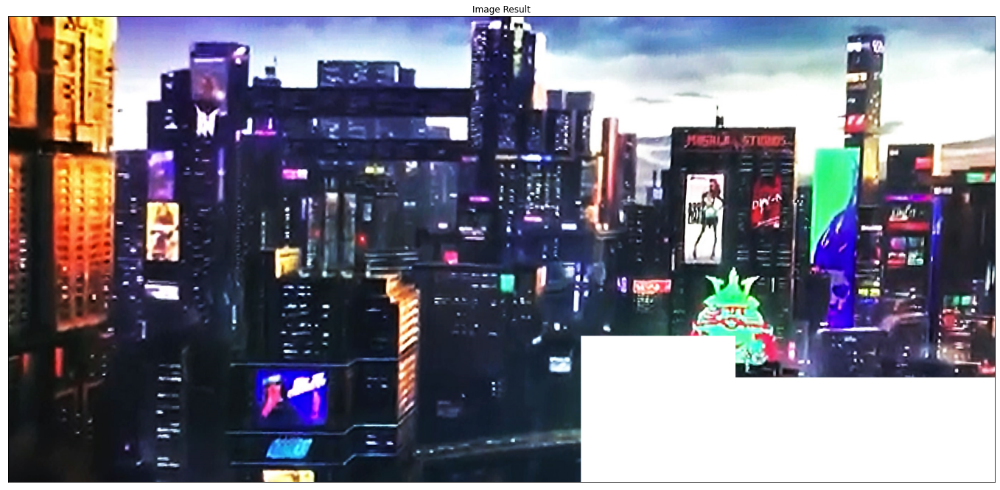

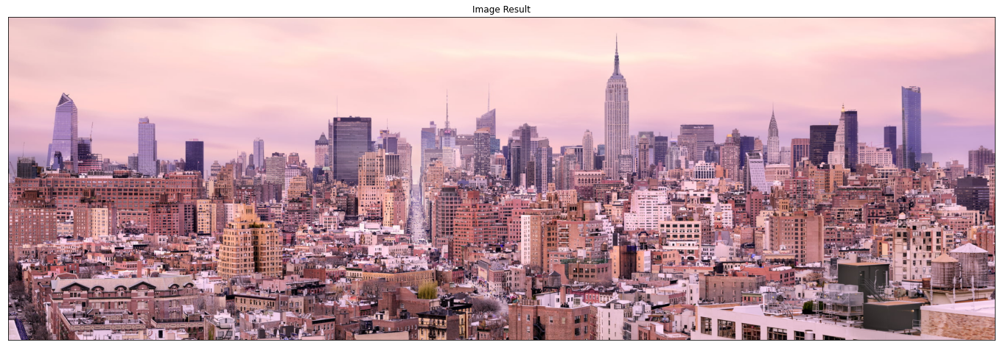

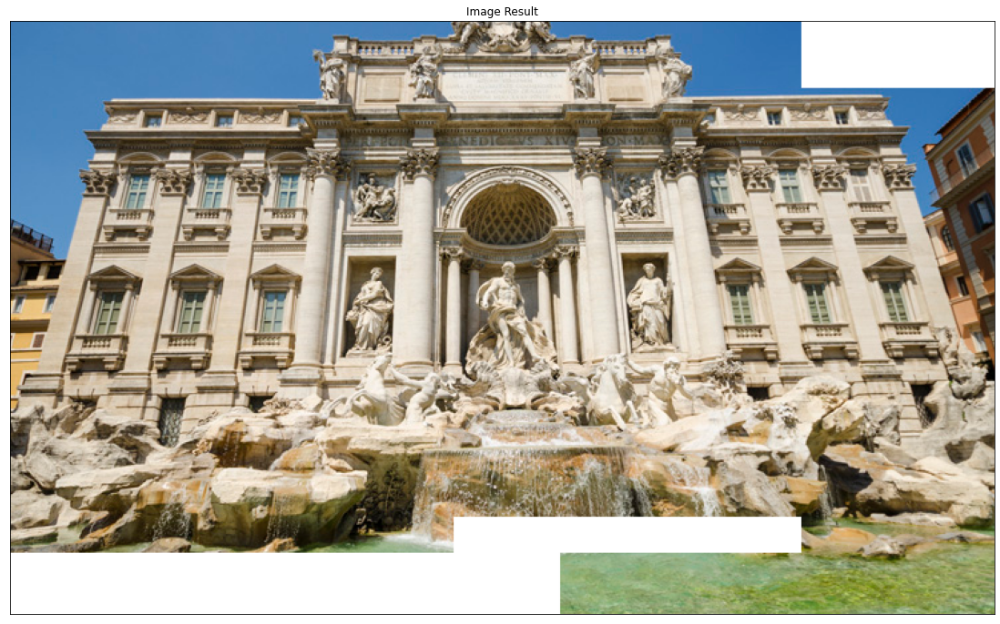

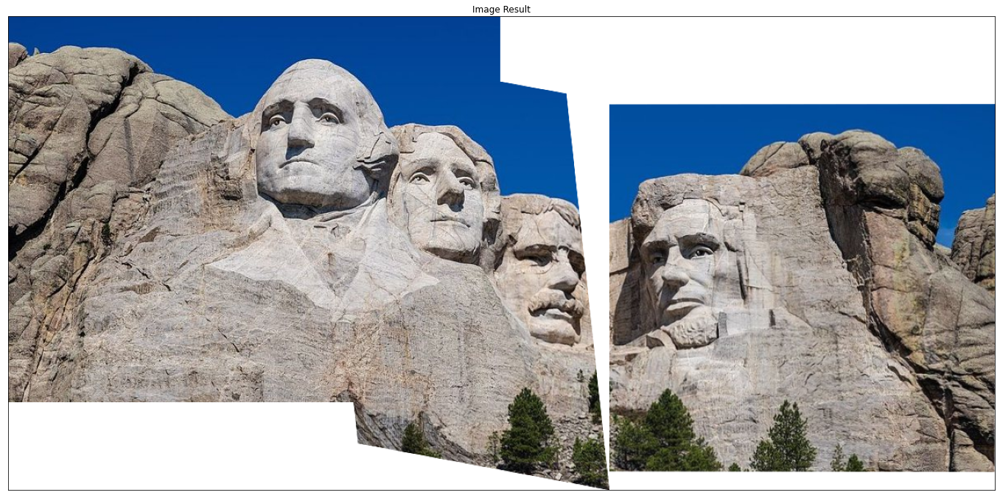

In [107]:
for i in range(0, n):
  plotImage(image[i], "Image Result")
  print()